In [57]:
import pandas as pd
import seaborn as sns
import matplotlib.pylab as plt
from scipy import stats

In [42]:
## FUNCIONES IMPORTANTES:

def scatterplot(data,x ,y ,hue=False):
    if hue==False:
        return sns.scatterplot(data=data, x=x, y=y, )
    else:
        return sns.scatterplot(data=data, x=x, y=y, hue=hue)

def boxplot(data,x ,y=False):
    if y==False:
        return sns.boxplot(data=data, x=x )
    else:
        return sns.boxplot(data=data, x=x, y=y, )




# 1. DESCRIPCIÓN DEL DATASET

## 1.1 Origen de los datos:
* Los datos fueron extraidos de kaggle.com, disponibles en el siguiente enlace: [https://www.kaggle.com/fedesoriano/stroke-prediction-dataset]

## 1.2 Contexto:
* Los certificados de depósito a término definido (CDT) son una importante fuente de ingresos para un banco. Estos consisten en una inversión en efectivo que se mantiene en una institución financiera. El dinero se invierte a un tipo de interés acordado durante un periodo de tiempo fijo. Un banco tiene varios medios de difusión para vender este tipo de instrumento financiero a sus clientes, como el marketing por correo electrónico, los anuncios, el marketing telefónico y el marketing digital.

* Las campañas de marketing telefónico siguen siendo una de las formas más eficaces de llegar al mercado objetivo. Sin embargo, requieren una gran inversión, ya que generalmente se terceriza el proceso de contacto, mediante grandes centros de llamadas para ejecutar las campañas. Por lo tanto, es crucial identificar de antemano a los clientes con más probabilidades de conversión para poder dirigirse específicamente a ellos mediante una llamada.

* Los datos están relacionados con las campañas de marketing directo (llamadas telefónicas) de una entidad bancaria portuguesa. El objetivo de la clasificación es predecir si el cliente aceptará adquirir un CDT o no.

## 1.3 Contenido: 
* Los datos están relacionados con las campañas de marketing directo de una institución bancaria portuguesa. Las campañas de marketing se basaban en llamadas telefónicas. A menudo, se requería más de un contacto con el mismo cliente, para dterminar si el producto (CDT) sería adquirido o no por el cliente. 

* El conjunto de datos está compuesto por dos subconjuntos:
    * Conjunto de entrenamiento (train.csv).
    * Conjunto de prueba (test.csv).

| Variable  | Significado                                                                                                                                                | Tipo variable | Valores                                                                                                                                            |
|-----------|------------------------------------------------------------------------------------------------------------------------------------------------------------|---------------|----------------------------------------------------------------------------------------------------------------------------------------------------|
| age       | edad del cliente contactado                                                                                                                                | Numérico      |                                                                                                                                                    |
| job       | tipo de trabajo del cliente                                                                                                                                | Categórico    | "admin.","unknown","unemployed","management","housemaid","entrepreneur","student", "blue-collar","self-employed","retired","technician","services" |
| marital   | Estado civíl del cliente                                                                                                                                   | Categórico    | "married","divorced","single"; note: "divorced" means divorced or widowed                                                                          |
| education | Nivel educativo del cliente                                                                                                                                | Categórico    | "unknown","secondary","primary","tertiary"                                                                                                         |
| default   | Flag si el cliente tiene crédito en mora                                                                                                                   | Binario       | "yes", "no"                                                                                                                                        |
| balance   | Saldo promedio anual en la cuenta (euros)                                                                                                                  | Numérico      |                                                                                                                                                    |
| Loan      | Flag si el cliente tiene algún prestamo                                                                                                                    | Binario       | "yes", "no"                                                                                                                                        |
| housing   | Flag si el cliente tiene crédito de vivienda                                                                                                               | Binario       | "yes", "no"                                                                                                                                        |
| contact   | Medio de contacto                                                                                                                                          | Categórico    | "unknown","telephone","cellular"                                                                                                                   |
| day       | Día del mes en que recibió el último contacto                                                                                                              | Numérico      |                                                                                                                                                    |
| month     | Mes en el cual recibió el último contacto                                                                                                                  | Categórico    | "jan", "feb", "mar", …, "nov", "dec"                                                                                                               |
| duration  | Duración en segundos del último contacto                                                                                                                   | Numérico      |                                                                                                                                                    |
| campaing  | Número de contactos que recibió el cliente para esta campaña. Incluido el último contacto                                                                  | Numérico      |                                                                                                                                                    |
| pdays     | Número de días que han pasado desde la última vez que se contactó al cliente para otra campaña. -1 indica que el cliente no ha sido contactado previamente | Númerico      |                                                                                                                                                    |
| previous  | Número de contactos realizados al cliente para esta campaña                                                                                                | Númerico      |                                                                                                                                                    |
| poutcome  | Resultado de la última campaña                                                                                                                             | Categórico    | "unknown","other","failure","success"                                                                                                              |
| y         | Variable de respuesta sobre si el cliente acepta o no                                                                                                      | Binario       | "yes", "no"                                                                                                                                        |

    



## 1.4 Cantidad:
* train.csv: 45.211 filas y 18 columnas ordenadas por fecha (de mayo de 2008 a noviembre de 2010)
* test.csv: 4521 filas y 18 columnas con el 10% de los ejemplos (4521), seleccionados aleatoriamente de train.csv

## 1.5 Distribución:
Se mostrará la distribución de las variables del dataset

Se hace la lectura de los datos y se almacena en la variable 'banking'

In [7]:
banking = pd.read_csv("Banking/train.csv", sep=";") #Las columnas se encuentran separadas por ;

Se imprime el encabezado del dataset para tener un primer acercamiento a los datos

In [58]:
banking.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y,month_code
0,58,management,married,tertiary,no,2143,yes,no,unknown,5,may,261,1,-1,0,unknown,no,4
1,44,technician,single,secondary,no,29,yes,no,unknown,5,may,151,1,-1,0,unknown,no,4
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,5,may,76,1,-1,0,unknown,no,4
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,5,may,92,1,-1,0,unknown,no,4
4,33,unknown,single,unknown,no,1,no,no,unknown,5,may,198,1,-1,0,unknown,no,4


### - AGE

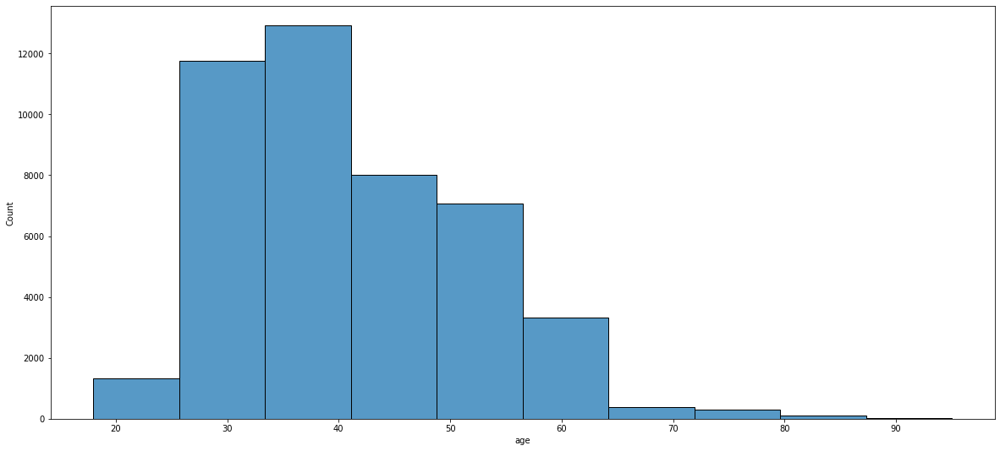

In [9]:
plt.figure(figsize = (20, 9))
sns.histplot(data = banking, x = 'age', bins = 10);

### - JOB

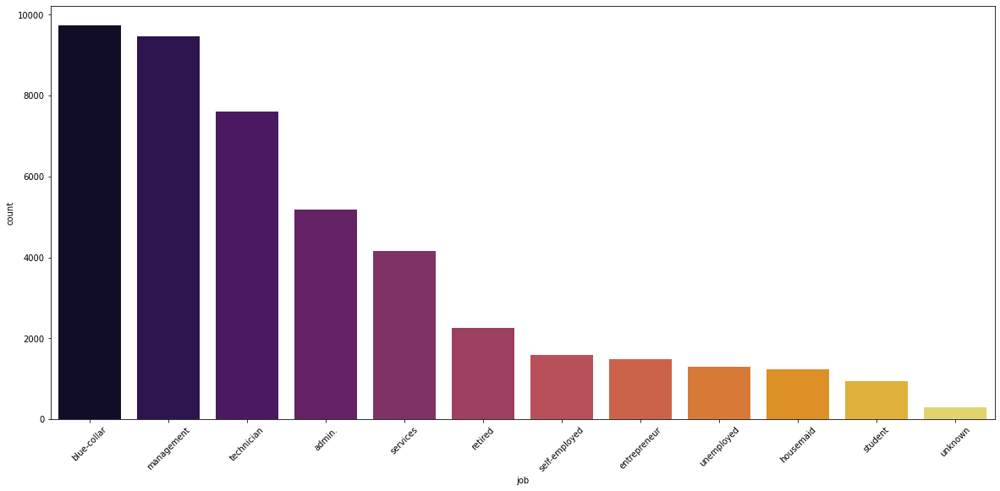

In [10]:
plt.figure(figsize = (20, 9))
sns.countplot(x = 'job', data = banking, order = banking['job'].value_counts().index, palette = 'inferno')
plt.xticks(rotation = 45);

### - MARITAL

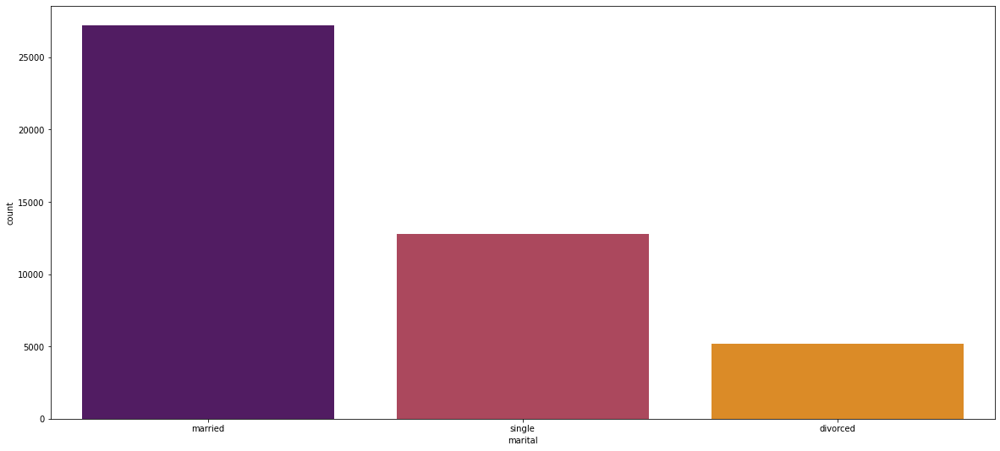

In [11]:
plt.figure(figsize = (20, 9))
sns.countplot(x = 'marital', data = banking, order = banking['marital'].value_counts().index, palette = 'inferno');

### - EDUCATION

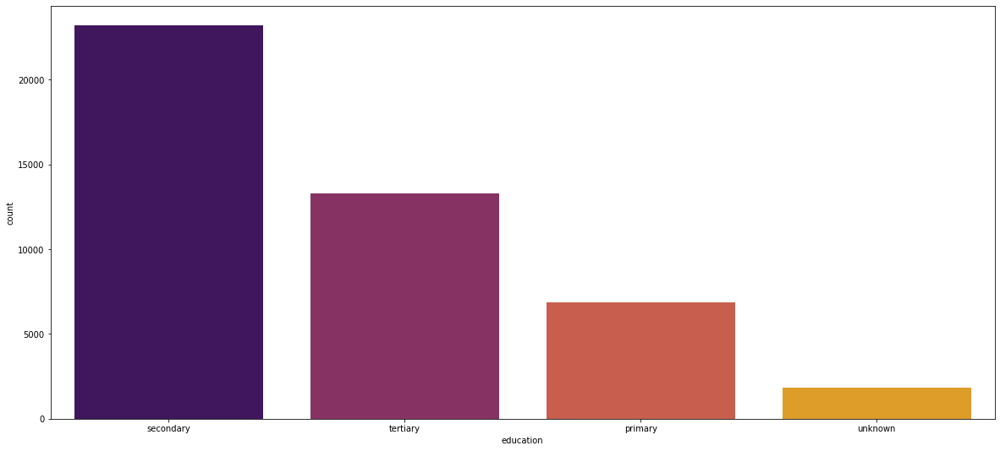

In [12]:
plt.figure(figsize = (20, 9))
sns.countplot(x = 'education', data = banking, order = banking['education'].value_counts().index, palette = 'inferno');

### - DEFAULT

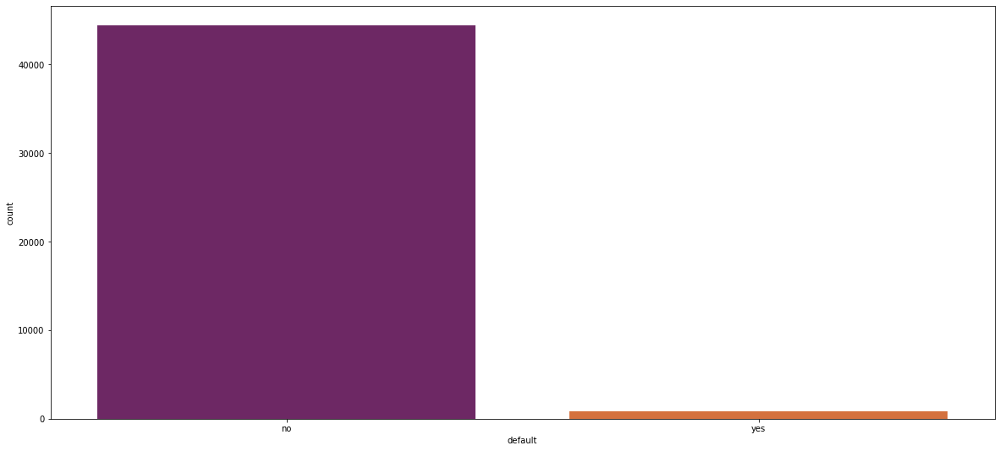

In [13]:
plt.figure(figsize = (20, 9))
sns.countplot(x = 'default', data = banking, order = banking['default'].value_counts().index, palette = 'inferno');

### - BALANCE

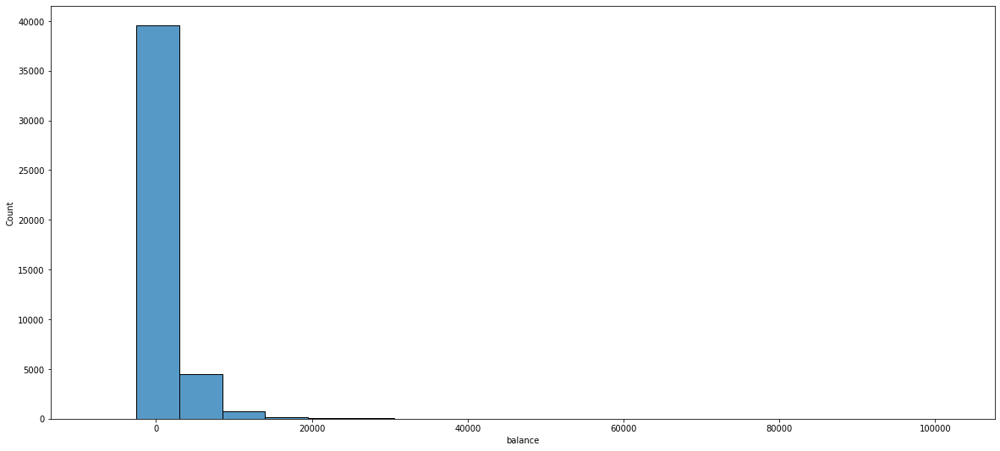

In [14]:
plt.figure(figsize = (20, 9))
sns.histplot(data = banking, x = 'balance', bins = 20);

### - HOUSING

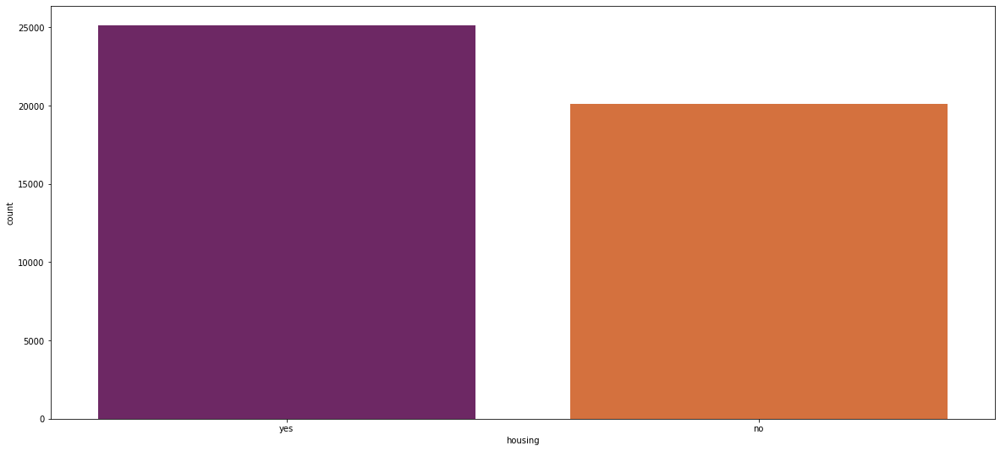

In [15]:
plt.figure(figsize = (20, 9))
sns.countplot(x = 'housing', data = banking, order = banking['housing'].value_counts().index, palette = 'inferno');

### - LOAN

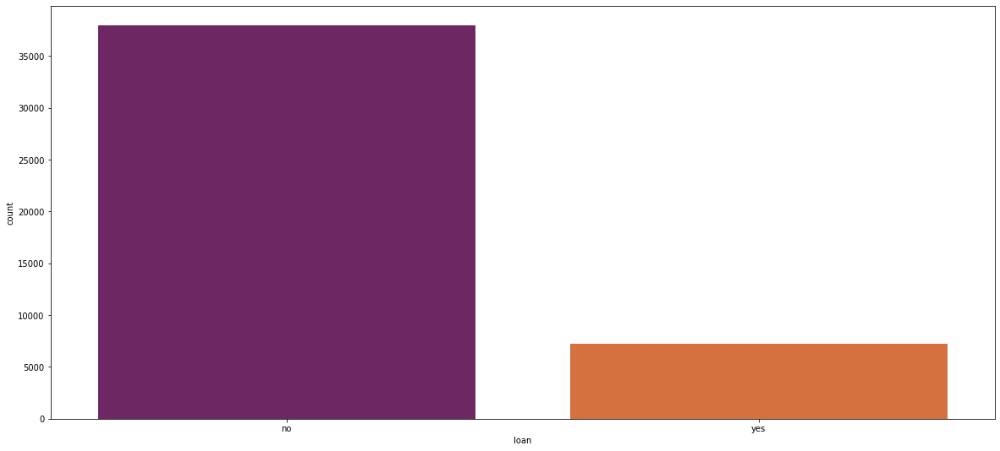

In [16]:
plt.figure(figsize = (20, 9))
sns.countplot(x = 'loan', data = banking, order = banking['loan'].value_counts().index, palette = 'inferno');

### - CONTACT

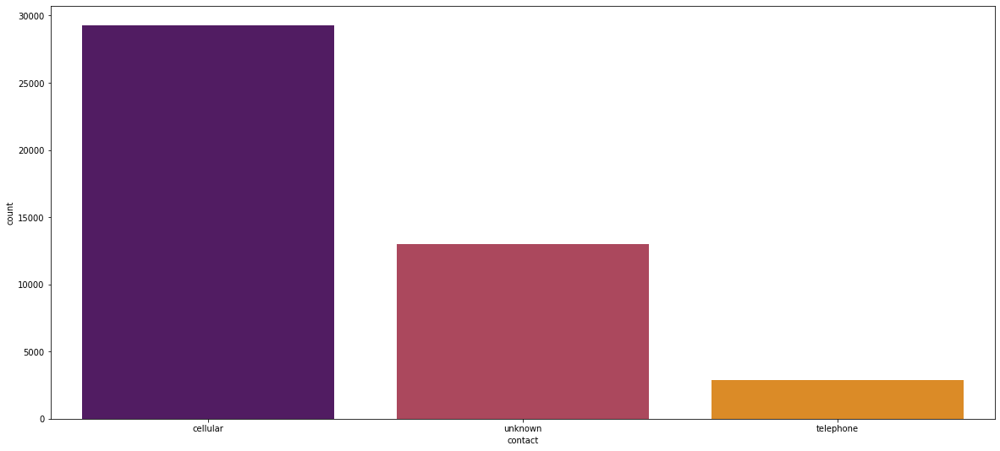

In [17]:
plt.figure(figsize = (20, 9))
sns.countplot(x = 'contact', data = banking, order = banking['contact'].value_counts().index, palette = 'inferno');

### - DAY

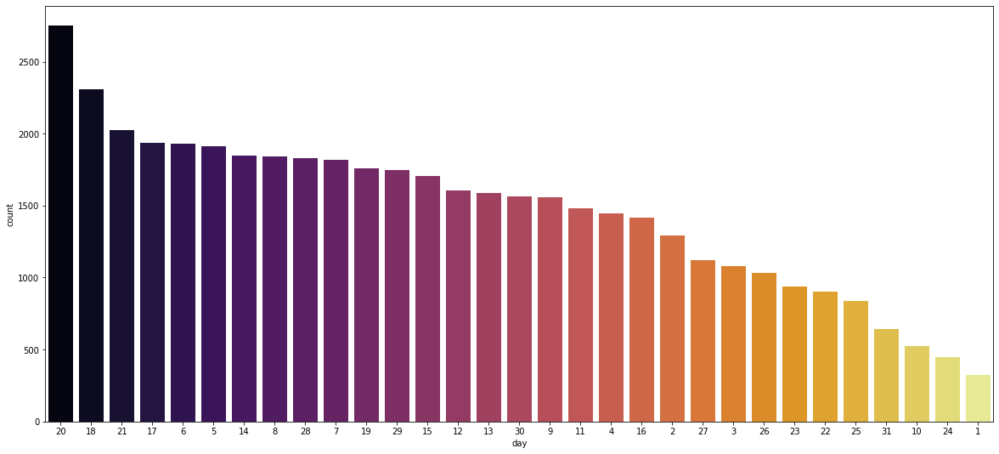

In [18]:
plt.figure(figsize = (20, 9))
sns.countplot(x = 'day', data = banking, order = banking['day'].value_counts().index, palette = 'inferno');

### - MONTH

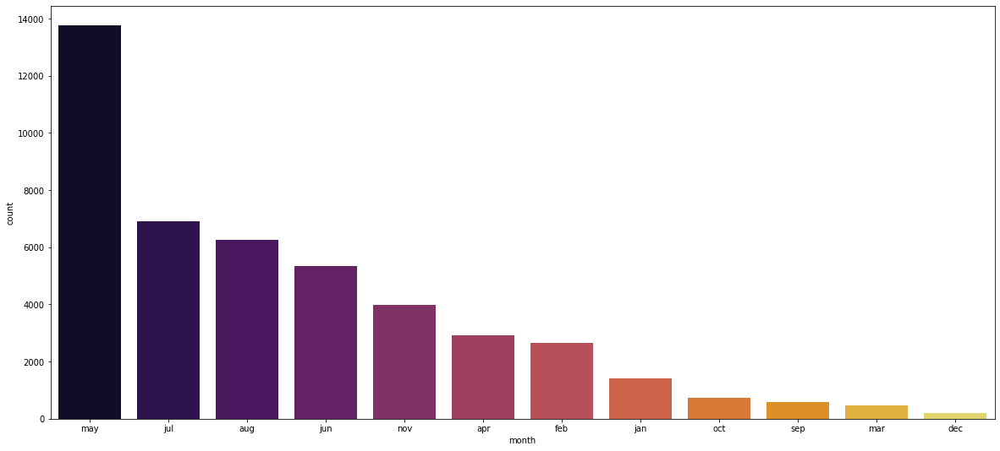

In [19]:
plt.figure(figsize = (20, 9))
sns.countplot(x = 'month', data = banking, order = banking['month'].value_counts().index, palette = 'inferno');

### - DURATION

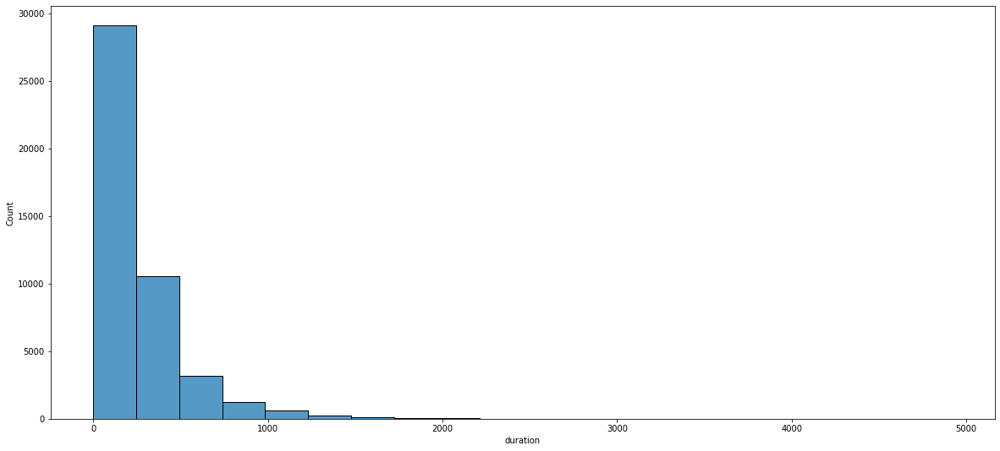

In [20]:
plt.figure(figsize = (20, 9))
sns.histplot(data = banking, x = 'duration', bins = 20);

### - CAMPAIGN

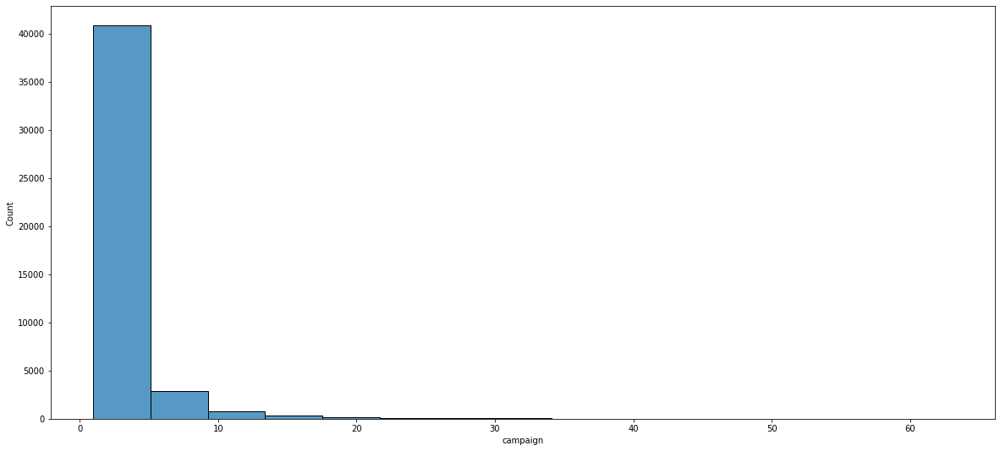

In [21]:
plt.figure(figsize = (20, 9))
sns.histplot(data = banking, x = 'campaign', bins = 15);

### - PDAYS

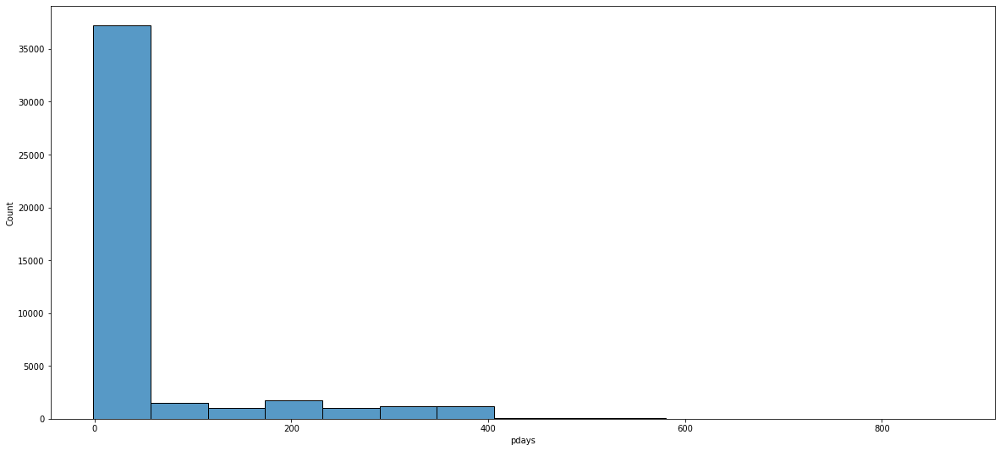

In [22]:
plt.figure(figsize = (20, 9))
sns.histplot(data = banking, x = 'pdays', bins = 15);

### - PREVIOUS

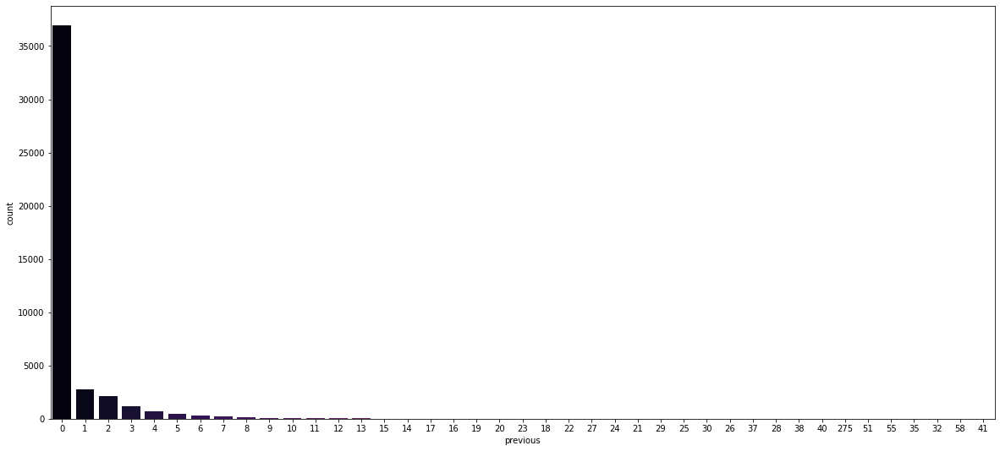

In [23]:
plt.figure(figsize = (20, 9))
sns.countplot(x = 'previous', data = banking, order = banking['previous'].value_counts().index, palette = 'inferno');

### - POUTCOME

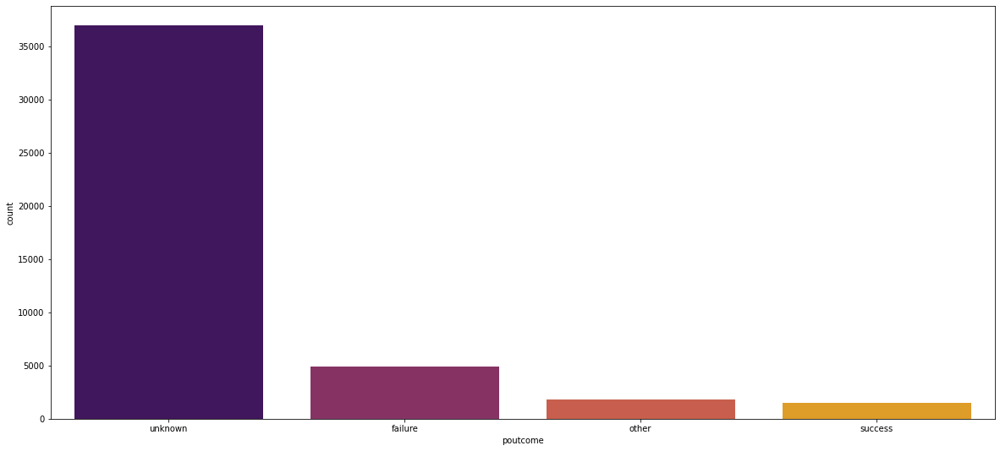

In [24]:
plt.figure(figsize = (20, 9))
sns.countplot(x = 'poutcome', data = banking, order = banking['poutcome'].value_counts().index, palette = 'inferno');

### - Y (OUTPUT VARIABLE)

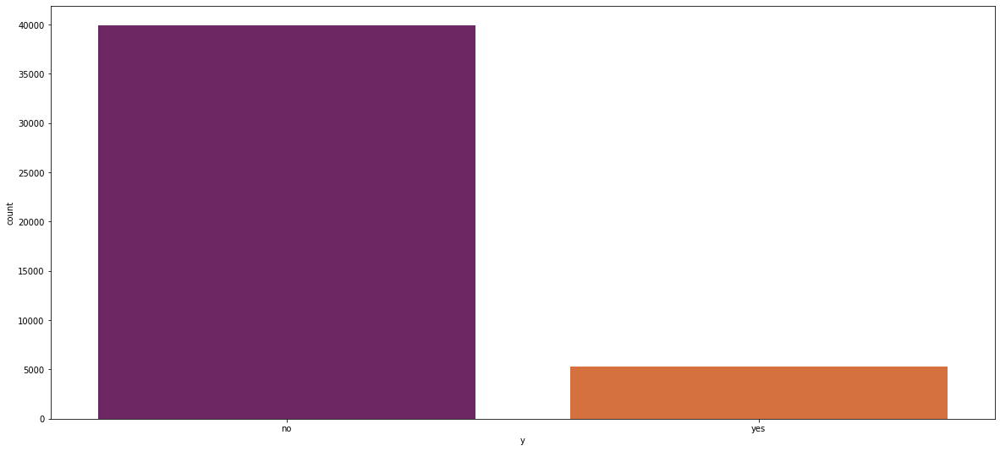

In [25]:
plt.figure(figsize = (20, 9))
sns.countplot(x = 'y', data = banking, order = banking['y'].value_counts().index, palette = 'inferno');

## 1.6 Limitantes y supuestos

El principal limitante que se tiene con los datos, es la ausencia de una persona especializada en el negocio, que pueda ampliar el contexto de los datos. Dado esto, será necesario asumir el significado de ciertos valores faltantes, dejándolo a libre interpretación del equipo de trabajo.

Conociendo la naturaleza de las variables poutcome y pdays, se puede inferir que los registros que tienen un valor de poutcome igual a 'unknown' son aquellos que no han sido contactados en campañas previas, es decir, aquellos cuyo valor de pdays es igual a '-1'.




In [26]:
banking.poutcome.value_counts()

unknown    36959
failure     4901
other       1840
success     1511
Name: poutcome, dtype: int64

In [27]:
banking.pdays.value_counts()

-1      36954
 182      167
 92       147
 91       126
 183      126
        ...  
 465        1
 529        1
 18         1
 434        1
 831        1
Name: pdays, Length: 559, dtype: int64

# 2. Metodología:

## 2.1 Análisis multivariado

* Se investiga los tipos de variables que se tienen, para identificar facilmente las numéricas y categóricas:


In [28]:
banking.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 17 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   age        45211 non-null  int64 
 1   job        45211 non-null  object
 2   marital    45211 non-null  object
 3   education  45211 non-null  object
 4   default    45211 non-null  object
 5   balance    45211 non-null  int64 
 6   housing    45211 non-null  object
 7   loan       45211 non-null  object
 8   contact    45211 non-null  object
 9   day        45211 non-null  int64 
 10  month      45211 non-null  object
 11  duration   45211 non-null  int64 
 12  campaign   45211 non-null  int64 
 13  pdays      45211 non-null  int64 
 14  previous   45211 non-null  int64 
 15  poutcome   45211 non-null  object
 16  y          45211 non-null  object
dtypes: int64(7), object(10)
memory usage: 5.9+ MB


In [29]:
# from sklearn.preprocessing import LabelEncoder

# banking_copy = banking.copy()

# #Se obtiene la lista de atributos categóricos
# categories = [c for c in banking_copy.columns if banking_copy[c].dtypes =='object']

# #Por cada atributo categórico entrene un codificador y transforme el atributo con base en ese codificador
# for c in categories:
#     le = LabelEncoder()
#     le.fit(list(df_train[c].astype('str')))
#     df_train[c] = le.transform(list(df_train[c].astype(str))) 

# #Muestre la información del conjunto de datos tras la transformación
# df_train.info()

* Se crea una variable auxiliar que representa la correspondencia numérica para los respectivos meses de la variable month:

In [30]:
banking['month'].unique()

array(['may', 'jun', 'jul', 'aug', 'oct', 'nov', 'dec', 'jan', 'feb',
       'mar', 'apr', 'sep'], dtype=object)

In [31]:
month_type = pd.api.types.CategoricalDtype(categories = ['jan', 'feb', 'mar', 'apr', 'may', 'jun', 'jul', 'aug', 'sep', 'oct', 'nov', 'dec'], ordered=True)
banking.month = banking.month.astype(month_type)

In [32]:
banking['month_code'] = banking['month'].cat.codes

In [33]:
banking.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y,month_code
0,58,management,married,tertiary,no,2143,yes,no,unknown,5,may,261,1,-1,0,unknown,no,4
1,44,technician,single,secondary,no,29,yes,no,unknown,5,may,151,1,-1,0,unknown,no,4
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,5,may,76,1,-1,0,unknown,no,4
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,5,may,92,1,-1,0,unknown,no,4
4,33,unknown,single,unknown,no,1,no,no,unknown,5,may,198,1,-1,0,unknown,no,4


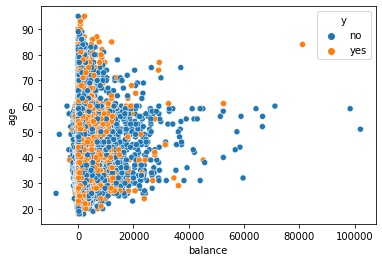

In [36]:
scatterplot(data=banking, x="balance", y="age", hue="y");

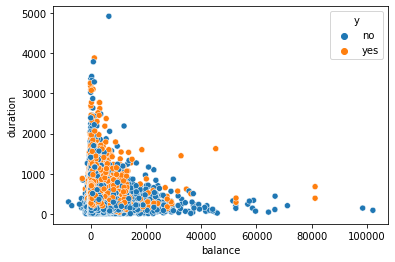

In [52]:
scatterplot(data=banking, x="balance", y="duration", hue="y");

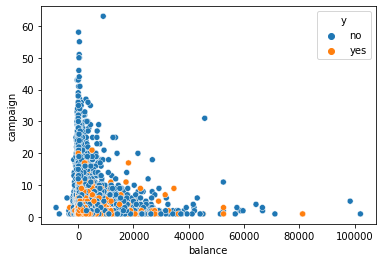

In [53]:
scatterplot(data=banking, x="balance", y="campaign", hue="y");

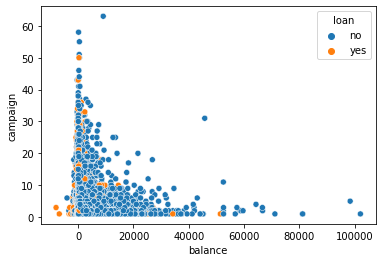

In [55]:
scatterplot(data=banking, x="balance", y="campaign", hue="loan");

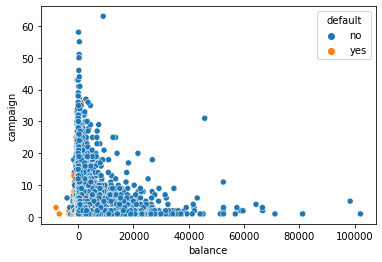

In [56]:
scatterplot(data=banking, x="balance", y="campaign", hue="default");

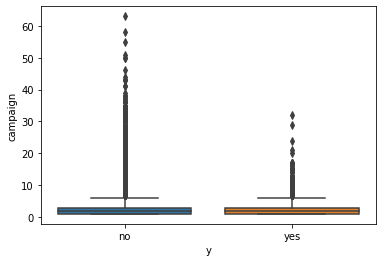

In [54]:
boxplot(x = 'y',  y = 'campaign', data = banking);

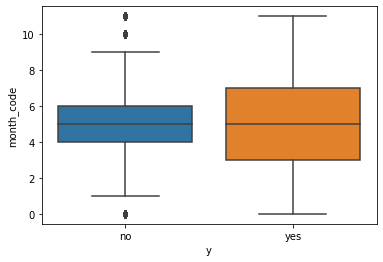

In [50]:
boxplot(x = 'y',  y = 'month_code', data = banking);

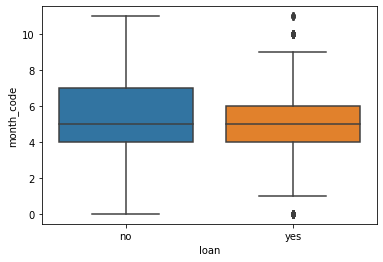

In [68]:
sns.boxplot(x = 'loan', y = 'month_code', data = banking);

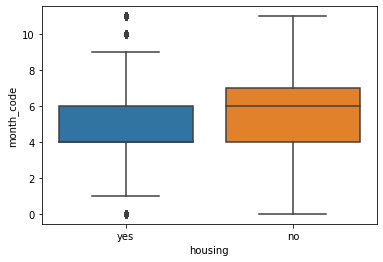

In [70]:
sns.boxplot(x = 'housing', y = 'month_code', data = banking);

* Observar tablas de contigencia que relacionen variables categóricas con la variable de respuesta, para determinar sin son independientes o no, por medio de un tests chi cuadrado:

y                no       yes     Total
education                              
primary    0.138462  0.013072  0.151534
secondary  0.459003  0.054190  0.513194
tertiary   0.250050  0.044149  0.294198
unknown    0.035500  0.005574  0.041074
Total      0.883015  0.116985  1.000000


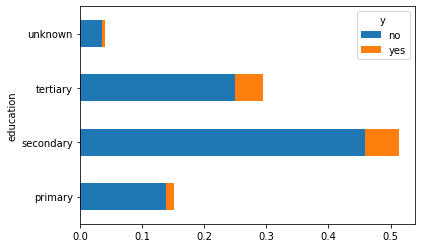

In [108]:
ct_education = pd.crosstab(banking.education, banking.y, normalize = True)
print(pd.crosstab(banking.education, banking.y, normalize = True,margins=True, margins_name = 'Total'))
ct_education.plot.barh(stacked=True);

y               no       yes     Total
marital                               
divorced  0.101413  0.013758  0.115171
married   0.540997  0.060936  0.601933
single    0.240605  0.042291  0.282896
Total     0.883015  0.116985  1.000000


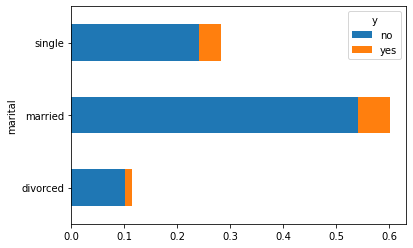

In [107]:
ct_marital = pd.crosstab(banking.marital, banking.y, normalize = True)
print(pd.crosstab(banking.marital, banking.y, normalize = True, margins=True, margins_name = 'Total'))
ct_marital.plot.barh(stacked=True);

y                    no       yes     Total
job                                        
admin.         0.100418  0.013957  0.114375
blue-collar    0.199597  0.015660  0.215257
entrepreneur   0.030170  0.002721  0.032890
housemaid      0.025016  0.002411  0.027427
management     0.180421  0.028776  0.209197
retired        0.038663  0.011413  0.050076
self-employed  0.030789  0.004136  0.034925
services       0.083719  0.008162  0.091880
student        0.014797  0.005950  0.020747
technician     0.149455  0.018580  0.168034
unemployed     0.024352  0.004468  0.028820
unknown        0.005618  0.000752  0.006370
Total          0.883015  0.116985  1.000000


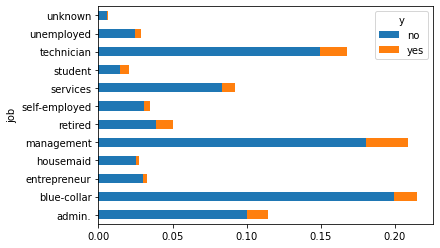

In [109]:
ct_job = pd.crosstab(banking.job, banking.y, normalize = True)
print(pd.crosstab(banking.job, banking.y, normalize = True, margins=True, margins_name = 'Total'))
ct_job.plot.barh(stacked=True);

y              no       yes     Total
default                              
no       0.866139  0.115835  0.981973
yes      0.016876  0.001150  0.018027
Total    0.883015  0.116985  1.000000


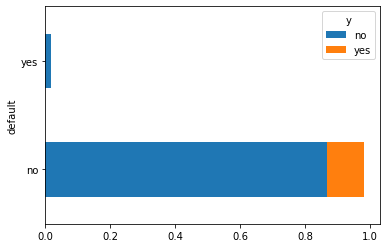

In [110]:
ct_default = pd.crosstab(banking.default, banking.y, normalize = True)
print(pd.crosstab(banking.default, banking.y, normalize = True, margins=True, margins_name = 'Total'))
ct_default.plot.barh(stacked=True);

y              no       yes     Total
housing                              
no       0.369976  0.074185  0.444162
yes      0.513039  0.042799  0.555838
Total    0.883015  0.116985  1.000000


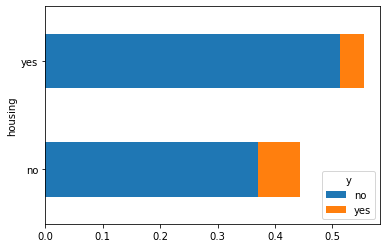

In [111]:
ct_housing = pd.crosstab(banking.housing, banking.y, normalize = True)
print(pd.crosstab(banking.housing, banking.y, normalize = True, margins=True, margins_name = 'Total'))
ct_housing.plot.barh(stacked=True);

In [123]:
ct_hou = pd.crosstab(banking.marital, banking.job)
print(pd.crosstab(banking.marital, banking.job))#normalize = True, margins=True, margins_name = 'Total'))
# ct_housing.plot.barh(stacked=True);

job       admin.  blue-collar  entrepreneur  housemaid  management  retired  \
marital                                                                       
divorced     750          750           179        184        1111      425   
married     2693         6968          1070        912        5400     1731   
single      1728         2014           238        144        2947      108   

job       self-employed  services  student  technician  unemployed  unknown  
marital                                                                      
divorced            140       549        6         925         171       17  
married             993      2407       54        4052         731      203  
single              446      1198      878        2620         401       68  


In [124]:

(chi2, p, dof, _) = stats.chi2_contingency([ct_hou.iloc[0].values, ct_hou.iloc[1].values])

In [125]:
print('chi2', chi2)
print('p-value', p)
print('Dof', dof)

chi2 410.85265212879875
p-value 3.0349194366401007e-81
Dof 11


In [145]:
(chi2, p, dof, exp) = stats.chi2_contingency(ct_education)

In [147]:
stats.chi2_contingency(ct_education)

(0.0052846321949100005,
 0.9998979877012456,
 3,
 array([[0.13380675, 0.01772717],
        [0.45315783, 0.06003586],
        [0.25978158, 0.03441673],
        [0.03626903, 0.00480504]]))

In [ ]:
def crosstab(data, feature1, feature2):
    ct = pd.crosstab(data[feature1], data[feature2])
    


y             no   yes
education             
primary     6260   591
secondary  20752  2450
tertiary   11305  1996
unknown     1605   252


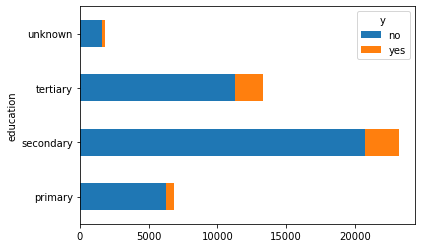

In [152]:
ct_education2 = pd.crosstab(banking.education, banking.y)
print(pd.crosstab(banking.education, banking.y))#, margins=True, margins_name = 'Total'))
ct_education2.plot.barh(stacked=True);

In [150]:
stats.chi2_contingency(ct_education2)

(238.92350616407606,
 1.6266562124072994e-51,
 3,
 array([[ 6049.5371038 ,   801.4628962 ],
        [20487.71856407,  2714.28143593],
        [11744.98511424,  1556.01488576],
        [ 1639.75921789,   217.24078211]]))

# Presentación de resultados

# Análisis y conclusiones